In [2]:
import numpy as np
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

In [3]:
data = pd.read_csv("./Police_Department_Incident_Reports__2018_to_Present_20231025.csv")

In [7]:
crime = data.copy()

In [4]:
crime.shape

(786625, 35)

In [5]:
crime.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 786625 entries, 0 to 786624
Data columns (total 35 columns):
 #   Column                                                Non-Null Count   Dtype  
---  ------                                                --------------   -----  
 0   Incident Datetime                                     786625 non-null  object 
 1   Incident Date                                         786625 non-null  object 
 2   Incident Time                                         786625 non-null  object 
 3   Incident Year                                         786625 non-null  int64  
 4   Incident Day of Week                                  786625 non-null  object 
 5   Report Datetime                                       786625 non-null  object 
 6   Row ID                                                786625 non-null  int64  
 7   Incident ID                                           786625 non-null  int64  
 8   Incident Number                             

In [6]:
incident_category = crime['Incident Category'].unique()
print(incident_category)

['Recovered Vehicle' 'Larceny Theft' 'Assault' 'Lost Property'
 'Drug Violation' 'Malicious Mischief' 'Drug Offense' 'Non-Criminal'
 'Fraud' 'Warrant' 'Other Offenses' 'Robbery' 'Case Closure'
 'Other Miscellaneous' 'Stolen Property'
 'Offences Against The Family And Children' 'Other' 'Motor Vehicle Theft'
 'Traffic Collision' 'Suspicious Occ' 'Missing Person'
 'Disorderly Conduct' 'Weapons Carrying Etc' 'Rape' 'Burglary'
 'Fire Report' 'Arson' 'Vandalism' 'Suicide' 'Traffic Violation Arrest'
 'Courtesy Report' 'Forgery And Counterfeiting' 'Sex Offense'
 'Prostitution' 'Weapons Offense' 'Miscellaneous Investigation'
 'Vehicle Misplaced' 'Embezzlement' 'Suspicious' nan 'Civil Sidewalks'
 'Vehicle Impounded' 'Liquor Laws'
 'Human Trafficking, Commercial Sex Acts' 'Gambling' 'Homicide'
 'Motor Vehicle Theft?' 'Human Trafficking (A), Commercial Sex Acts'
 'Weapons Offence' 'Human Trafficking (B), Involuntary Servitude']


In [7]:
crime.head(20)

,Incident Datetime,Incident Date,Incident Time,Incident Year,Incident Day of Week,Report Datetime,Row ID,Incident ID,Incident Number,CAD Number,...,Longitude,Point,Neighborhoods,ESNCAG - Boundary File,Central Market/Tenderloin Boundary Polygon - Updated,Civic Center Harm Reduction Project Boundary,HSOC Zones as of 2018-06-05,Invest In Neighborhoods (IIN) Areas,Current Supervisor Districts,Current Police Districts
0,2023/03/13 11:41:00 PM,2023/03/13,23:41,2023,Monday,2023/03/13 11:41:00 PM,125373607041,1253736,230167874,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2023/03/01 05:02:00 AM,2023/03/01,05:02,2023,Wednesday,2023/03/11 03:40:00 PM,125379506374,1253795,236046151,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2023/03/13 01:16:00 PM,2023/03/13,13:16,2023,Monday,2023/03/13 01:17:00 PM,125357107041,1253571,220343896,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2023/03/13 10:59:00 AM,2023/03/13,10:59,2023,Monday,2023/03/13 11:00:00 AM,125355107041,1253551,230174885,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2023/03/14 06:44:00 PM,2023/03/14,18:44,2023,Tuesday,2023/03/14 06:45:00 PM,125402407041,1254024,230176728,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2023/02/15 03:00:00 AM,2023/02/15,03:00,2023,Wednesday,2023/03/11 04:55:00 PM,125378606372,1253786,236046123,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2023/03/11 12:30:00 PM,2023/03/11,12:30,2023,Saturday,2023/03/12 04:15:00 PM,125381606244,1253816,236046004,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,2023/03/13 11:26:00 AM,2023/03/13,11:26,2023,Monday,2023/03/13 01:37:00 PM,125419506244,1254195,236046850,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,2023/03/11 03:00:00 PM,2023/03/11,15:00,2023,Saturday,2023/03/13 08:29:00 AM,125420606244,1254206,236045937,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,2023/03/11 02:00:00 PM,2023/03/11,14:00,2023,Saturday,2023/03/15 11:21:00 AM,125431804134,1254318,230182844,230741133.0,...,-122.454285,POINT (-122.45428511766733 37.772895177200766),NaN,NaN,NaN,NaN,NaN,NaN,4.0,7.0


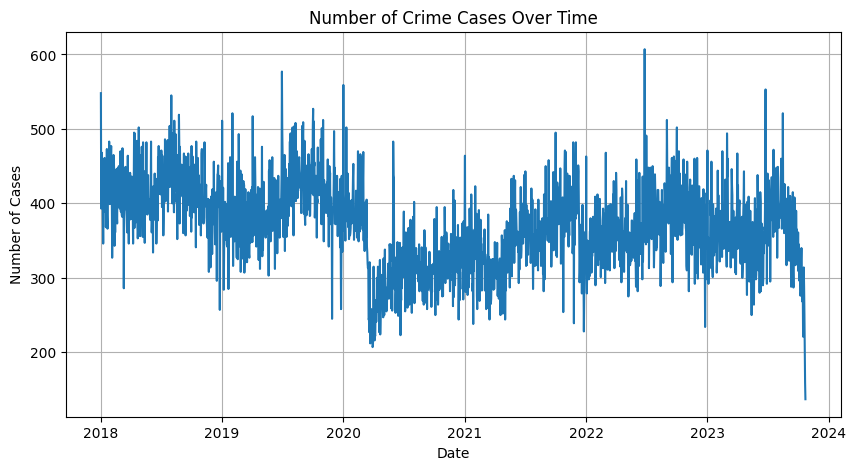

In [9]:
# Plot time series plot
crime['Incident Date'] = pd.to_datetime(crime['Incident Date'])
crime = crime.sort_values(by='Incident Date')
crime_count = crime['Incident Date'].dt.date.value_counts().sort_index()
plt.figure(figsize=(10, 5))
plt.plot(crime_count.index, crime_count.values, linestyle='-')
plt.title('Number of Crime Cases Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Cases')
plt.grid(True)
plt.show()



In [16]:
crime['Year'] = crime['Incident Date'].dt.year
crime['DayOfYear'] = crime['Incident Date'].dt.dayofyear
crime['Month'] = crime['Incident Date'].dt.month

daily_crime_counts = crime.groupby(['Year', 'DayOfYear']).size().reset_index(name='Incident Counts')
monthly_crime_counts = crime.groupby(['Year', 'Month']).size().reset_index(name='Incident Counts')
year_day_of_week_count = crime.groupby(['Year','Incident Day of Week']).size().reset_index(name='Incident Counts')
day_of_week_count = crime.groupby(['Incident Day of Week']).size().reset_index(name='Incident Counts')

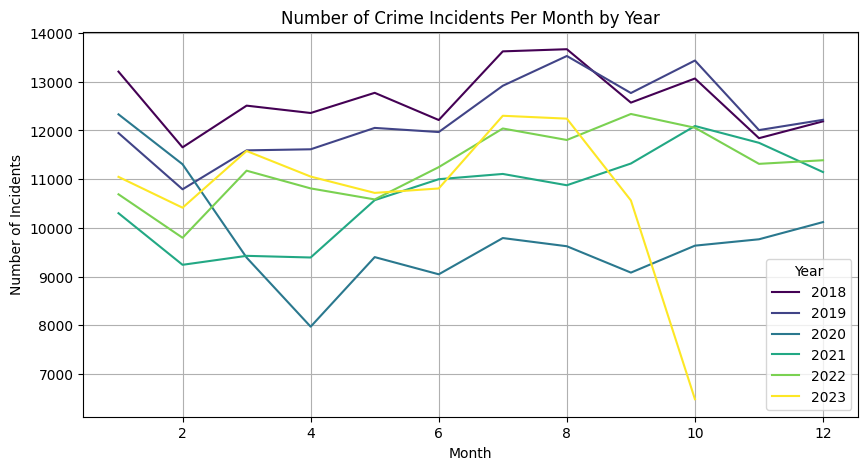

In [19]:
plt.figure(figsize=(10, 5))

years = monthly_crime_counts['Year'].unique()

colors = plt.cm.viridis(np.linspace(0, 1, len(years)))

for i, year in enumerate(years):
    subset = monthly_crime_counts[monthly_crime_counts['Year'] == year]
    plt.plot(subset['Month'], subset['Incident Counts'], label=year, color=colors[i])

plt.title('Number of Crime Incidents Per Month by Year')
plt.xlabel('Month')
plt.ylabel('Number of Incidents')
plt.legend(title='Year')
plt.grid(True)

plt.show()


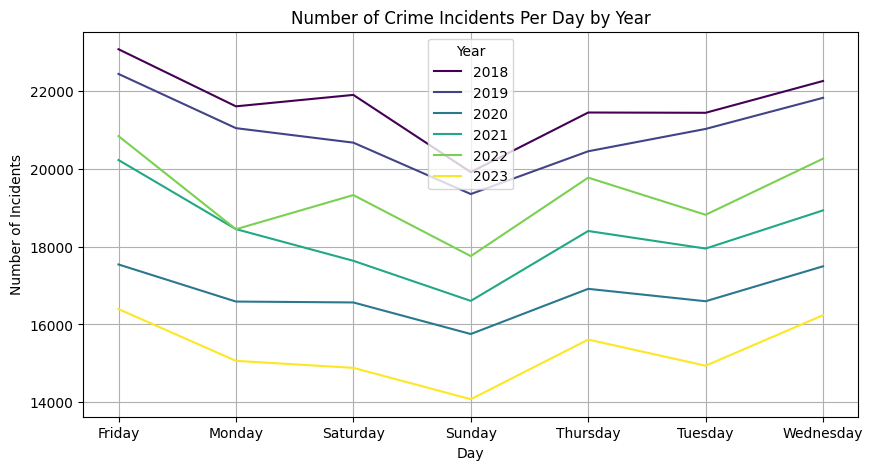

In [17]:
plt.figure(figsize=(10, 5))

years = year_day_of_week_count['Year'].unique()

colors = plt.cm.viridis(np.linspace(0, 1, len(years)))

for i, year in enumerate(years):
    subset = year_day_of_week_count[year_day_of_week_count['Year'] == year]
    plt.plot(subset['Incident Day of Week'], subset['Incident Counts'], label=year, color=colors[i])

plt.title('Number of Crime Incidents Per Day by Year')
plt.xlabel('Day')
plt.ylabel('Number of Incidents')
plt.legend(title='Year')
plt.grid(True)

plt.show()


  Incident Day of Week  Incident Counts
0               Friday           120533
1               Monday           111213
2             Saturday           110995
3               Sunday           103467
4             Thursday           112612
5              Tuesday           110782
6            Wednesday           117023


Text(0, 0.5, 'Number of Incidents')

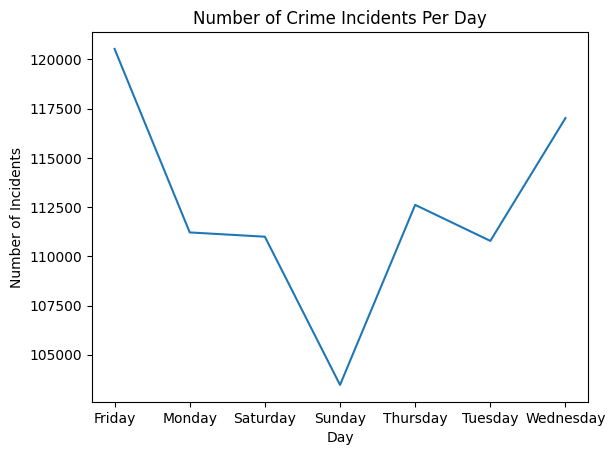

In [22]:
print(day_of_week_count)

plt.plot(day_of_week_count['Incident Day of Week'],day_of_week_count['Incident Counts'])
plt.title('Number of Crime Incidents Per Day')
plt.xlabel('Day')
plt.ylabel('Number of Incidents')

In [9]:
for year in [2018,2019,2020,2021,2022,2023]:
  temp=crime[crime['Incident Year'] == year]
  print(year,temp.shape[0])

2018 151668
2019 146834
2020 117461
2021 128214
2022 135240
2023 107208


In [15]:
crime['Incident Time'] = pd.to_datetime(crime['Incident Time'])
crime['Hour of Day'] = crime['Incident Time'].dt.hour
hour_incident_counts = crime.groupby('Hour of Day').size()


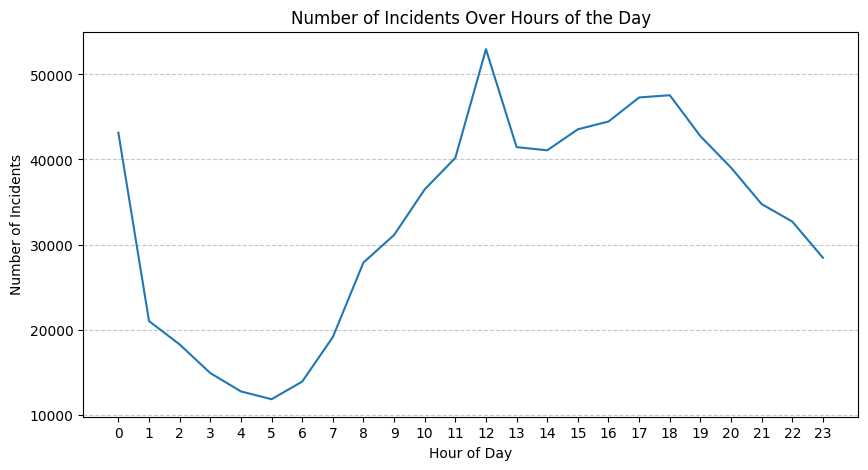

In [18]:
plt.figure(figsize=(10, 5))
hour_incident_counts.plot()
plt.title('Number of Incidents Over Hours of the Day')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Incidents')
plt.xticks(range(0, 24), range(0, 24))  # Optional: ensures all hours are shown
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

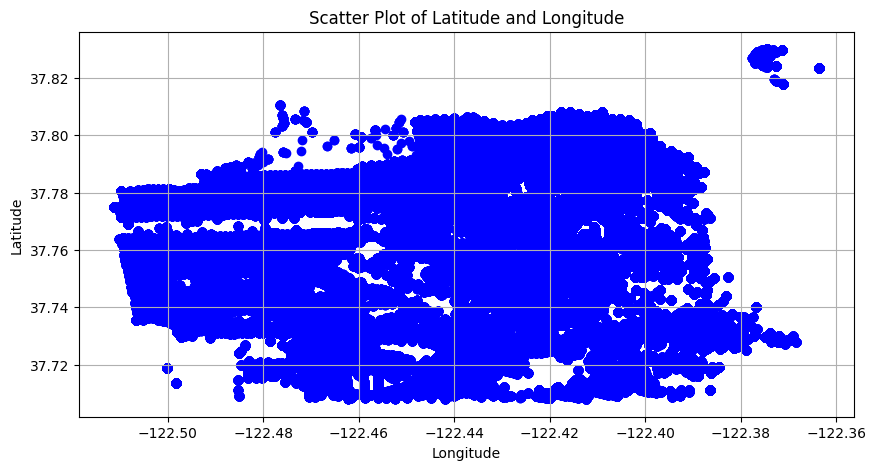

In [21]:
plt.figure(figsize=(10, 5))
plt.scatter(crime['Longitude'], crime['Latitude'], c='blue', marker='o')
plt.title('Scatter Plot of Latitude and Longitude')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()


In [8]:
crime_l = crime.dropna(subset=['Latitude', 'Longitude'])
lat_bins = np.linspace(crime_l['Latitude'].min(), crime_l['Latitude'].max(), 100)
lon_bins = np.linspace(crime_l['Longitude'].min(), crime_l['Longitude'].max(), 100)

# Compute the 2D histogram
h, xedges, yedges = np.histogram2d(crime_l['Latitude'], crime_l['Longitude'], bins=[lat_bins, lon_bins])


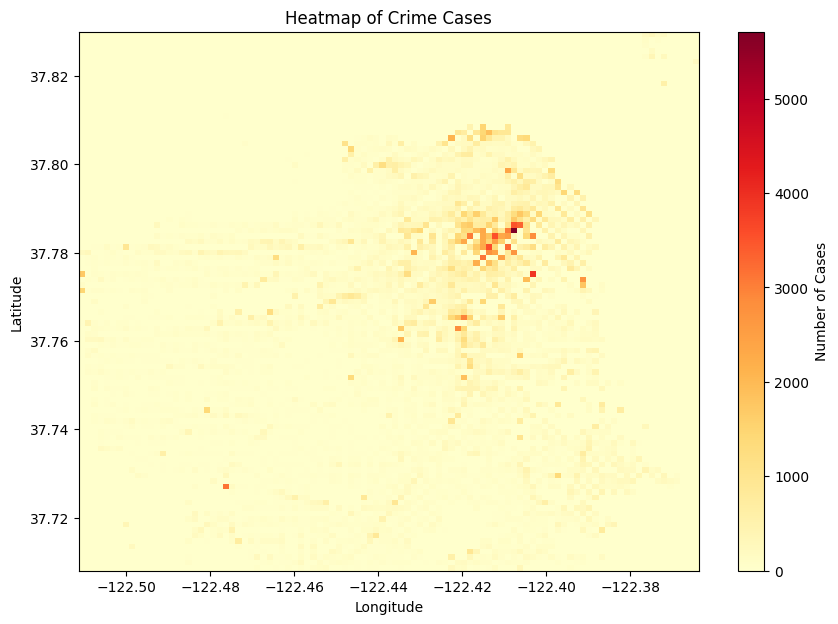

In [9]:


plt.figure(figsize=(10, 7))
plt.hist2d(crime_l['Longitude'], crime_l['Latitude'], bins=[lon_bins, lat_bins], cmap='YlOrRd')
plt.title('Heatmap of Crime Cases')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.colorbar(label='Number of Cases')
plt.show()



In [1]:
pip install folium

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 102.3/102.3 kB 2.5 MB/s eta 0:00:00
  Using cached Jinja2-3.1.2-py3-none-any.whl (133 kB)
Note: you may need to restart the kernel to use updated packages.


In [5]:
import geopandas as gpd
import contextily as cx
import folium
from folium.plugins import HeatMap

In [10]:
m = folium.Map([37.7749, -122.4194], zoom_start=13)
heat_data = [[row['Latitude'], row['Longitude']] for index, row in crime_l.iterrows()]

# Add heatmap to map
HeatMap(heat_data).add_to(m)
m

In [11]:
m.save('heatmap_san_francisco.html')
